# 202.6. Pixel mask planes

<div style="max-width:300px; float: left; margin-right: 1em">

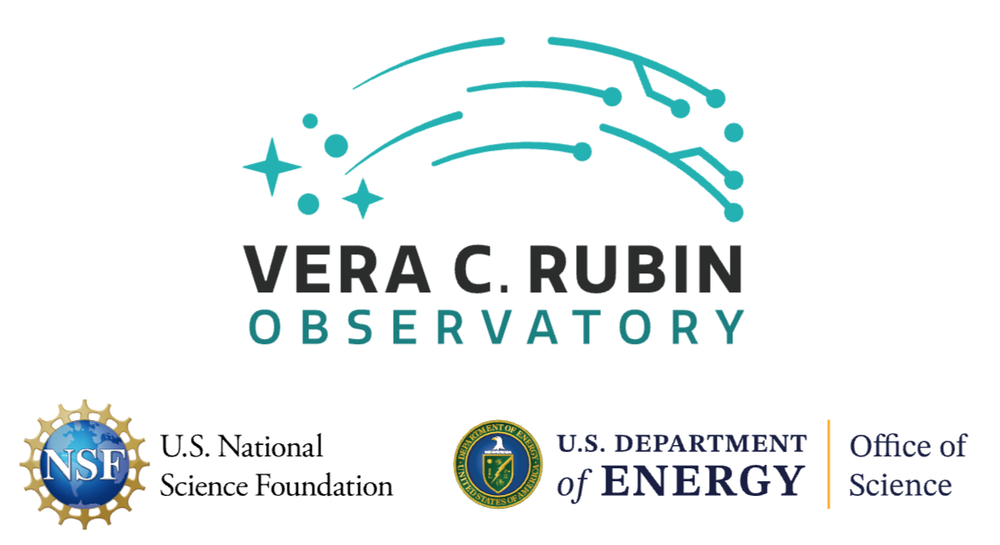

</div>

For the Rubin Science Platform at data.lsst.cloud. \
Data Release: [Data Preview 1](https://dp1.lsst.io/)\
Container Size: large \
LSST Science Pipelines version: r29.2. \
Last verified to run: 2025-12-08 \
Repository: [github.com/lsst/tutorial-notebooks](https://github.com/lsst/tutorial-notebooks) \
DOI: [10.11578/rubin/dc.20250909.20](https://doi.org/10.11578/rubin/dc.20250909.20\) 

**Learning objective:** To illustrate the pixel mask planes in DP1 images.

**LSST data products:** `deep_coadd`

**Packages:** `lsst.daf.butler`, `lsst.rsp`, `lsst.afw.display`

**Credit:**
Originally developed by Andrés A. Plazas Malagón, Melissa Graham, and the Rubin Community Science team with input from Jim Bosch and Yusra AlSayyad. 
Please consider acknowledging them if this notebook is used for the preparation of journal articles, software releases, or other notebooks.

**Get Support:**
Everyone is encouraged to ask questions or raise issues in the 
<a href="https://community.lsst.org/c/support">Support Category</a> 
of the Rubin Community Forum.
Rubin staff will respond to all questions posted there.

## 1. Introduction

In the LSST Science Pipelines, each processed image includes not only the measured flux values but also a companion bit mask image that records the condition of every pixel.
These mask planes encode information about detector defects, cosmic rays, saturation, missing data, and other effects that influence data quality. Each named mask plane corresponds to a specific bit flag that can be set independently or in combination with others on a given pixel.

For example, if bit 1 corresponds to a saturated pixel (`SAT`) and bit 3 to a pixel that has been hit by a cosmic ray (`CR`), a pixel with a mask value of 10 in binary indicates that both `SAT` and `CR` planes are active for that pixel (i.e., 2$^1$+ 2$^3$ = 10, see Section 3.3).
This compact representation makes it easy to test or combine conditions with bitwise operations.

This tutorial introduces the concept of mask planes in the LSST Science Pipelines and explains how to interpret them in Data Preview 1 (DP1) images.
It also provides examples of how to visualize mask information, showing how colors correspond to specific mask flags, and how to use this information to assess image quality and understand the provenance of masked regions in the data.

**Related tutorials:** Image tutorials in the 200 series.

### 1.1. Import packages

From the LSST Science Pipelines import the packages for the Butler, 2-dimensional sky geometry, and for image display.

In [ ]:
from lsst.daf.butler import Butler, Timespan
import lsst.afw.display as afwDisplay
import numpy as np
from astropy.time import Time
import matplotlib.pyplot as plt

### 1.2. Define parameters and functions

Instantiate the Butler.

In [ ]:
butler = Butler("dp1", collections="LSSTComCam/DP1")
assert butler is not None

Set `afw_display` to use `Firefly` and open the Firefly display tab.

In [ ]:
afwDisplay.setDefaultBackend('firefly')
afw_display = afwDisplay.Display(frame=1)

**Function**: `show_mask_planes`

Print all available mask planes with their bit value and display color.

In [ ]:
def show_mask_planes(mask):
    """
    Print all available mask planes with their bit value (2^n) and display color,
    ordered by ascending bit value.

    Parameters
    ----------
    mask : `lsst.afw.image.Mask`
        Mask object.
    """
    plane_dict = mask.getMaskPlaneDict()
    sorted_planes = sorted(plane_dict.items(), key=lambda item: item[1])

    print(f"{'Mask Plane': <20} {'Bit': <5} {'2^n': <6} {'Hex': <10} {'Default Color'}")
    print("-" * 60)

    for name, bit in sorted_planes:
        color = afw_display.getMaskPlaneColor(name)
        value = 2**bit
        hex_value = hex(value)
        print(f"{name: <20} {bit: <5} {value: <6} {hex_value: <8} {color}")

## 2. Descriptions

Descriptions of the flags in the `deep_coadd` and `visit_images` mask planes can be found in the [DP1 documentation](https://dp1.lsst.io).  
The following table provides a summary.

| Mask Plane           | Image Type      | Description (DP1-specific) |
|----------------------|------------------|-----------------------------|
| **BAD**               | visit + coadd    | Permanently bad pixels, including entire bad amplifiers. Excluded from science use. |
| **SAT**               | visit + coadd    | The flux in this pixel was too high to be accurately recorded (exceeded the PTC turnoff point). In coadds, indicates saturation in at least part of the stack at this location. |
| **INTRP**             | visit + coadd    | Pixel value was replaced via interpolation (typically due to `BAD`, `SAT`, or `CR`). For coadds, all inputs had this pixel interpolated or it was interpolated during stacking. |
| **CR**                | visit + coadd    | Pixels hit by a cosmic ray; interpolated in visits. In coadds, one or more input visits flagged this pixel as a cosmic ray. |
| **EDGE**              | visit + coadd    | Region unprocessed where the convolution kernel footprint extended beyond the image edge. |
| **DETECTED**          | visit + coadd    | Pixel footprint belongs to a detected source above threshold. In coadds, detection occurred on the coadd. |
| **DETECTED_NEGATIVE** | difference       | Negative source detection in difference images. |
| **SUSPECT**           | visit + coadd    | Pixel above the PTC turnoff but not fully saturated; not dilated like `SAT`. Propagates if a configurable fraction of inputs flagged it. |
| **NO_DATA**           | visit + coadd    | No valid data (chip gap, missing coverage, or failed amplifier). |
| **VIGNETTED**         | visit + coadd    | Pixels vignetted by optics; low-weight or low-quality data. In coadds, vignetted in all contributing visits. |
| **STREAK**            | difference       | Linear artifact such as a satellite trail or diffraction spike. |
| **CLIPPED**           | coadd only       | At least one input image for this pixel was identified as an artifact and excluded. |
| **CROSSTALK**         | visit + coadd    | Pixel affected by electronic crosstalk from a bright source in another amplifier. In coadds, flagged in at least one input. |
| **INEXACT_PSF**       | coadd only       | PSF poorly defined or inconsistent across inputs. Appears with at least one of `SENSOR_EDGE`, `CLIPPED`, or `REJECTED`. |
| **ITL_DIP**           | visit + coadd    | “ITL dip” artifact: dark vertical trails from bright sources on ITL CCDs. For coadds, flagged in at least one input. |
| **NOT_DEBLENDED**     | visit + coadd    | Pixel in a source footprint that was not successfully deblended. |
| **REJECTED**          | coadd only       | Pixel where a contributing image was masked and not used. |
| **SENSOR_EDGE**       | coadd only       | Pixel lies within a margin near the edge of at least one contributing input image. |
| **UNMASKEDNAN**       | visit + coadd    | Pixel contains a NaN without an accompanying mask flag; indicates invalid data. |
| **INJECTED**          | visit only       | Pixels with synthetic sources injected for testing or validation. |
| **INJECTED_TEMPLATE** | difference       | Pixels with synthetic sources injected into template images for difference imaging tests. |
| **SAT_TEMPLATE**      | difference       | Pixel saturated in the template image used for difference imaging. |


> **Table 1:** Summary of descriptions of the flags in the `deep_coadd` and `visit_images` mask planes.

### 2.1. Relation to artifacts

Several image artifacts caused by the camera, detector, or processing steps remain visible in DP1.
The [DP1 artifacts documentation](https://dp1.lsst.io/overview/artifacts.html) provides examples and definitions for many of these effects.
Some artifacts are **explicitly flagged** in the pixel-level `mask` plane, while others are not masked but may still impact photometry, shape, or background estimation.
The table below summarizes known artifact types in DP1 and indicates which, if any, mask planes are associated with each.

| Artifact Type           | Description                                                                                      | Related Mask Planes      | Notes                                                                                     |
|:-------------------------|:--------------------------------------------------------------------------------------------------|:---------------------------|:--------------------------------------------------------------------------------------------|
| **Bad pixels**          | Dead or misbehaving pixels, including “vampire” pixels.                                          | `BAD`, `INTRP`            | `BAD` flags the defect; `INTRP` set if interpolated over.                                 |
| **Bad columns**         | Entire vertical columns of defective pixels.                                                     | `BAD`, `INTRP`            | Persistent column defects; often interpolated during visit processing.                    |
| **Bleed trails**        | Overflow of charge from saturated stars vertically along columns.                                | `SAT`, `INTRP`, `SUSPECT` | `SAT` is dilated to cover bleed; adjacent pixels may be flagged `SUSPECT` or `INTRP`.     |
| **Dark trails**         | Negative flux columns following a bleed trail (seen on ITL CCDs).                                | `ITL_DIP`                 | Masked during ISR; modeled specifically for ITL sensors.                                  |
| **Edge bleed**          | Horizontal artifact along the edge after vertical bleeding reaches the CCD boundary.             | `SAT`, `SUSPECT`, `EDGE`  | No unique plane.                                               |
| **Crosstalk**           | Ghost image from bright source mirrored into another amplifier.                                  | `CROSSTALK`               | Subtracted in ISR; residual is masked with `CROSSTALK`.                                   |
| **Cosmic rays**         | Bright, sharp spots from high-energy particle hits.                                              | `CR`, `INTRP`             | `CR` marks origin; `INTRP` used if patched.                                                |
| **Satellites / Streaks**| Bright linear trails from satellites or debris.                                                  | `STREAK`                  | In DP1, `STREAK` is set only in visit images if detected in difference imaging.           |
| **Interpolation**       | Pixel value filled in algorithmically (e.g. over CR, bad pixel, or bleed).                       | `INTRP`                   | Indicates pixel value is not from real data.                                               |
| **Stray light**         | Off-axis light scattered into the focal plane.                                                   | _None_                    | Visually visible; not masked in DP1.                                                       |
| **Ghost / Ghoul / Glint** | Internal reflections from bright stars or camera hardware.                                      | _None_                    | Visible as diffuse or bright patches; unmasked.                                            |
| **Amplifier jump**      | Blocky offsets between amplifiers due to gain mismatch.                                          | _None_                    | ISR attempts correction; unmasked if residual remains.                                    |
| **Fringing**            | Interference pattern, most visible in z- and y-band exposures.                                   | _None_                    | Processed photometrically; no associated mask plane.                                      |
| **Tree rings**          | Circular variations in pixel area from silicon manufacturing.                                    | _None_                    | Small astrometric effect; no mask in DP1.                                                  |
| **Crosshatch pattern**  | Correlated noise pattern from overscan subtraction.                                                     | _None_                    | Subtle; visible in low-background visits; unmasked.                                       |
| **Dark edge**           | Background over-subtraction at image edges or corners.                                           | _None_                    | Artifact from sky subtraction; not masked.                                                 |
| **Dark halo**           | Background over-subtraction near bright stars.                                                   | _None_                    | Common near very bright sources; visually evident but unmasked.                          |


> **Table 2:** DP1 artifacts and relation to mask planes.

### 2.2. Key mask planes 

Tables 3 and 4 describe how to treat mask planes when doing image analysis or source measurement with DP1 data, in a manner consistent with LSST Science Pipelines processing for DP1.
Note that pipelines may set certain planes during processing without always using them downstream (e.g., some algorithms ignore `INTERP` for PSF fitting).

- **Exclude**:  Pixels with this mask plane should be removed if they are still present; these generally indicate unusable data.

- **Retain**: Pixels may remain; these planes are typically propagated by the pipelines without discarding the data.

- **Conditional**: Use depends on science case; some algorithms may ignore or downweight these planes, but they are not universally excluded.

#### 2.2.1. Visit images
For single-visit images, most mask planes trace detector-level effects.
The most important mask planes to consider in image analyses are in Table 3.

| **Mask Plane** | **Recommended Use** | **Notes** |
|:----------------|:--------------------|:-----------|
| **BAD** | Conditional | Permanently bad pixels. Not suitable for science use if the affected area is large (e.g., an entire amplifier); usually well-interpolated and acceptable if the area is small (e.g., a bad column). |
| **SAT** | Exclude | Pixel saturated beyond the Photon Transfer Curve (PTC) turnoff point. Often propagates to coadds. |
| **CR** | Retain | Cosmic rays are well interpolated; no need to remove unless studying extremely rare or peculiar sources. |
| **INTRP** | Retain | Interpolated pixel (typically over `BAD`, `SAT`, or `CR`). Safe to retain for most analyses. |
| **SUSPECT** | Conditional | Near-saturation or uncertain response. Keep or reject depending on science goals. |
| **EDGE / SENSOR_EDGE** | Exclude | Marks detector edges; can propagate into coadds. |
| **NO_DATA** | Exclude | Region with no valid data (chip gap, missing coverage, failed amplifier). |
| **CROSSTALK** | Retain | Electronic signal induced by a bright source in a neighboring amplifier. |
| **ITL_DIP** | Exclude | "ITL dip" artifact: dark vertical trails from bright sources on ITL CCDs. |
| **VIGNETTED** | Conditional | Lower-quality data due to vignetting; may be included if weighted properly. |

> **Table 3:** Key mask planes in `visit_images`.

#### 2.2.2. Deep coadd images
For coadds, several mask planes indicate whether individual visits contributing to a pixel were excluded or degraded.
The most important mask planes to consider in image analyses are in Table 4.

| **Mask Plane** | **Recommended Use** | **Notes** |
|:----------------|:--------------------|:-----------|
| **CLIPPED** | Conditional | Input visit rejected during artifact removal (e.g., satellite trail). |
| **REJECTED** | Conditional | Input visits had masks intentionally removed (e.g., bad amplifier, bleed trail, vignetted region). |
| **INEXACT_PSF** | Conditional | Set if any of `CLIPPED`, `REJECTED`, or `SENSOR_EDGE` were true; this indicates potentially discontinuous PSF modeling. This flag should be used only when extremely high PSF accuracy is required or when there are very few visits (such that PSF discontinuities will not average down).|
| **NO_DATA** | Exclude | Every contributing visit was excluded, rejected, or clipped — often around saturated stars. |
| **SAT** | Exclude | Coadd pixel affected by saturation in one or more contributing visits. |
| **CR** | Retain | Cosmic-ray–affected pixels, interpolated in stacking. |
| **INTRP** | Retain | Interpolated values from single-visit images; generally fine for most science analyses. |

> **Table 4:** Key mask planes in `deep_coadd`.

## 3. Deep coadd mask

Query for `deep_coadd` images that overlap the coordinates RA, Dec (in degrees) near the center of the DP1 Extended Chandra Deep Fields South (ECDFS) field and were obtained with the r-band filter.

In [ ]:
ra = 53.076
dec = -28.110
band = 'r'
query = f"band.name = '{band}' AND patch.region OVERLAPS POINT({ra}, {dec})"
dataset_refs = butler.query_datasets("deep_coadd", where=query)
assert len(dataset_refs) == 2
print(len(dataset_refs))
del ra, dec, band, query

For the first dataset reference returned by the query, get the corresponding `deep_coadd`.

In [ ]:
ref = dataset_refs[0]
deep_coadd = butler.get(ref)

### 3.1. Get the mask plane

Get the mask plane from the `deep_coadd` object.

In [ ]:
mask = deep_coadd.getMask()

### 3.2. Print the mask keys

Print the list of mask keys and default color.

In [ ]:
show_mask_planes(mask)

### 3.3. Interpret the mask values

Mask planes in the LSST Science Pipelines use a *bitmask representation*, meaning that each mask plane corresponds to one **bit** in the binary form of an integer.  
Each bit represents whether a particular condition is **True (1)** or **False (0)** for a given pixel.

Computers store numbers in binary, where each bit position corresponds to a power of two.  
For example:

| Bit Position | Binary | Power of Two | Decimal Value | Meaning (if used as a mask bit) |
|---------------|---------|---------------|----------------|--------------------------------|
| 0             | 0001    | $2^0$            | 1              | Plane #0 active (`BAD`)        |
| 1             | 0010    | $2^1$            | 2              | Plane #1 active (`SAT`)        |
| 2             | 0100    | $2^2$            | 4              | Plane #2 active (`INTRP`)      |
| 3             | 1000    | $2^3$            | 8              | Plane #3 active (`CR`)         |

If multiple planes are active, their bits are **combined by addition** (a bitwise OR operation).  
This means that the total mask value is the **sum of the powers of two** corresponding to all active bits.

For example, a mask value of 73744 is equal to $2^1 + 2^2 + 2^3 + 2^5 + 2^{13} + 2^{16}$. The exponets of these power of two expressions represent the bits for the `SAT`, `INTRP`, `CR`, `DETECTED`, `INEXACT_PSF`, and `REJECTED` mask planes. 

The `mask` object has a method to perform the conversion from value to mask planes automatically. 

In [ ]:
value = 73774
mask.interpret(value)

> **Warning:** Bit values are assigned dynamically and are not guaranteed to be fixed.

### 3.4  Check the values in the mask array

Print a list of the unique mask array values, the number of pixels with that value, and the overlapping masks for pixels with that value.

In [ ]:
values, counts = np.unique(mask.array, return_counts=True)

print(f"{'Hex': <8} {'Binary': <6} {'Counts': <8} {'Mask Planes': <30}")
print("-" * 60)

for value, count in zip(values, counts):
    hex_value = hex(value)
    print(f"{hex_value: <8} {value: <6} {count: <8} {mask.interpret(value): <30}")

### 3.6 Extract a specific plane

Calculate the fraction of pixels masked with the cosmic rays flag (`CR`).

In [ ]:
cr_plane = mask.getPlaneBitMask("CR")
cr_mask = (mask.array & cr_plane) != 0

In [ ]:
print("Fraction of pixels flagged as CR:", np.mean(cr_mask))

### 3.7 Display with Firefly

Display the `deep_coadd` in frame 1, and set the mask transparency to 0 (not transparent; to show the mask).

In [ ]:
afw_display.image(deep_coadd)
afw_display.setMaskTransparency(0)

With the mask plane fully opaque, it should look like this:

<div style="max-width:400px">

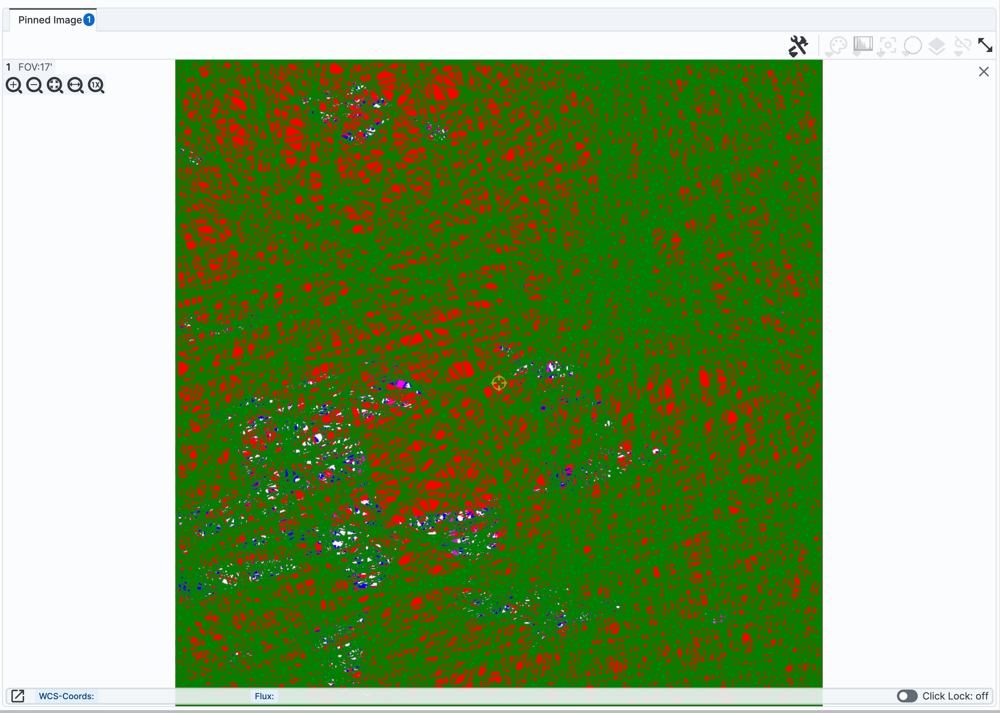

</div>

> **Figure 1:** The mask plane of the r-band `deep_coadd` image for tract 5063, patch 14. The colors correspond to an informative mask flag value (Section 3.2). Almost every pixel has a color (has a nonzero mask value).

Display the mask in Firefly frame 2.

In [ ]:
afw_display = afwDisplay.Display(frame=2)
afw_display.image(mask)

The mask plane should look like the image below.
Note the coordinates (“WCS”) and values (“Flux”) shown in the lower left: the coordinates are in pixels, and the values correspond to combined integer bit values per pixel (labeled as “Flux,” although in this case they do not represent a physical flux).

<div style="max-width:400px">

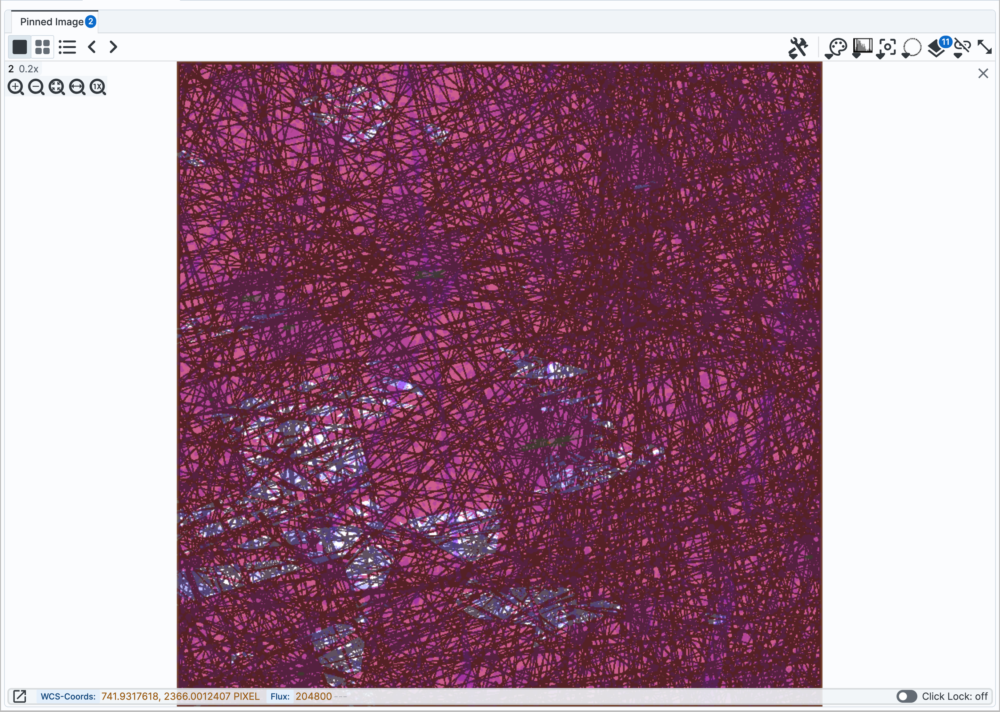

</div>

> **Figure 2:** The mask plane of the r-band `deep_coadd` image for tract 5063, patch 14.

Set all mask key names to transparent except the "DETECTED" mask bit, and display again in frame 1.

In [ ]:
afw_display = afwDisplay.Display(frame=1)
afw_display.setMaskTransparency(100)
afw_display.setMaskTransparency(0, 'DETECTED')

<div style="max-width:400px">

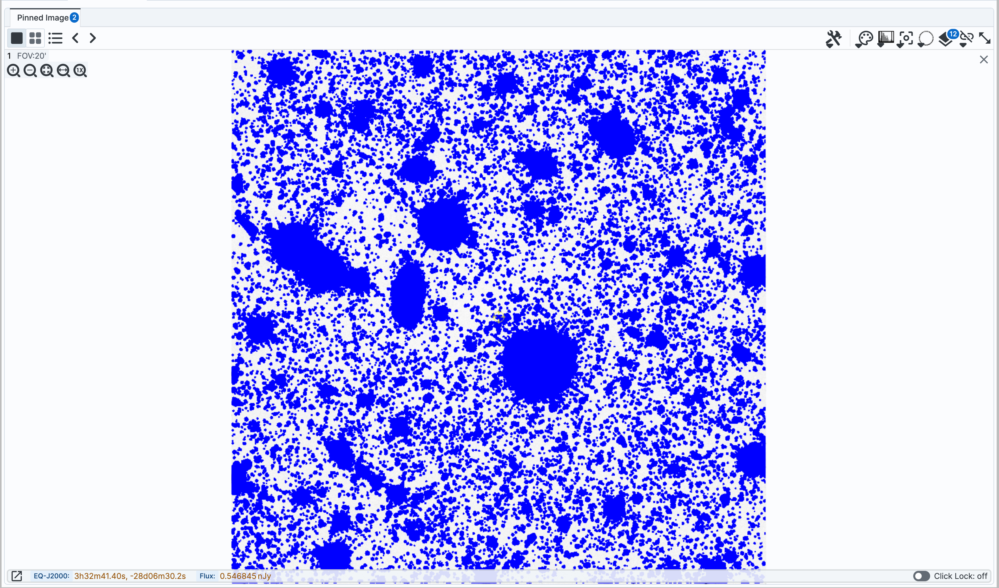

</div>

> **Figure 3:** Pixels marked with the  `DETECTED` mask bit.

### 3.8 Display with Matplotlib

Mask objects are **bitmasks**, not booleans.
Each bit encodes a different mask plane, so the numeric values cannot be interpreted as straightforward true/false flags.
As a result, plotting the `mask` image plane array **directly** with `matplotlib` can be misleading or confusing.

However, each individual mask plane can be extracted and plotted using `matplotlib` to provide a visualization of which pixels are masked by that specific plane across the image.

In [ ]:
fig = plt.figure(figsize=(12, 12))
for i, (name, bit) in enumerate(mask.getMaskPlaneDict().items()):
    fig.add_subplot(4, 5, i + 1)
    plt.imshow(mask.array & 2**bit, vmin=0, vmax=1,
               origin='lower', cmap='Greys',
               interpolation='nearest')
    plt.title(name)
    plt.axis('off')

> **Figure 4:** Individual mask planes arrays for a `deep_coadd` image displayed with `matplotlib`. 

Cleanup.

In [ ]:
del mask, values, counts, cr_plane, cr_mask

## 4. Visit image mask

Query for `visit_images` that overlap coordinates RA, Dec near the center of the ECDFS field, were obtained with the r-band filter, and a within timespan near the start of the LSSTComCam campaign.

In [ ]:
ra = 53.076
dec = -28.110
band = "r"
time1 = Time("2024-11-09T00:00:00.0", format="isot", scale="tai")
time2 = Time(60624.0, format="mjd", scale="tai")
timespan = Timespan(time1, time2)
del time1, time2

In [ ]:
dataset_refs = butler.query_datasets("visit_image",
                                     where="band.name = :band AND \
                                     visit.timespan OVERLAPS :timespan AND \
                                     visit_detector_region.region OVERLAPS POINT(:ra, :dec)",
                                     bind={"band": band, "timespan": timespan,
                                           "ra": ra, "dec": dec},
                                     order_by=["visit.timespan.begin"])
print(len(dataset_refs))

In [ ]:
del ra, dec, band, timespan

Get an image.

In [ ]:
ref = dataset_refs[1]
visit_image = butler.get(ref)

### 4.1. Get the mask plane
Get the mask plane from the `visit_image` object.

In [ ]:
mask_visit_image = visit_image.getMask()

### 4.2. Print the mask keys

Print the list of mask keys and default color.

In [ ]:
show_mask_planes(mask_visit_image)

### 4.3. Check the values in the mask array.
Print a list of the unique mask array values, the number of pixels with that value, and the overlapping masks for pixels with that value.

> **Warning:** Bit values are assigned dynamically and are not guaranteed to be fixed. 

In [ ]:
values, counts = np.unique(mask_visit_image.array, return_counts=True)

print(f"{'Hex': <8} {'Binary': <6} {'Counts': <8} {'Mask Planes': <30}")
print("-" * 60)

for value, count in zip(values, counts):
    hex_value = hex(value)
    print(f"{hex_value: <8} {value: <6} {count: <8} {mask_visit_image.interpret(value): <30}")

In [ ]:
values, counts = np.unique(mask_visit_image.array, return_counts=True)

print(f"{'Hex': <8} {'Binary': <6} {'Counts': <9} {'Mask Planes': <30}")
print("-" * 60)

for value, count in zip(values, counts):
    hex_value = hex(value)
    print(f"{hex_value: <8} {value: <6} {count: <9} {mask_visit_image.interpret(value): <30}")

### 4.4 Display with Firefly

Display the `visit_image` in frame 1, and set the mask transparency to 0 (not transparent; to show the mask).

In [ ]:
afw_display = afwDisplay.Display(frame=1)
afw_display.image(visit_image)
afw_display.setMaskTransparency(0)

With the mask fully opaque, it should look like this:

<div style="max-width:400px">

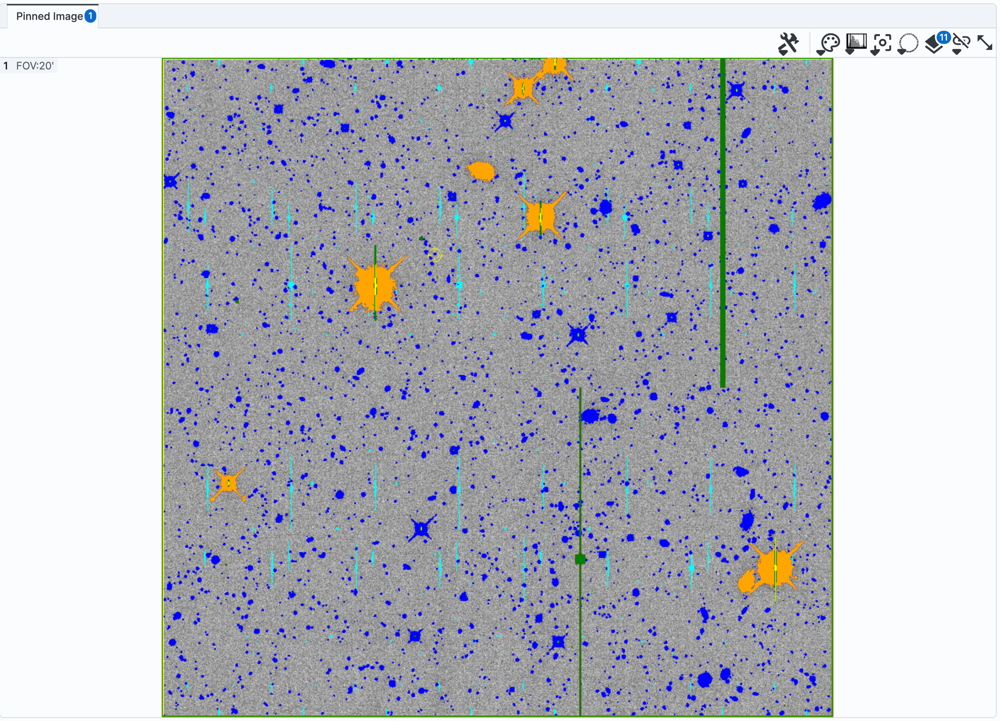

</div>

> **Figure 6:** `visit_image` image with mask overlaid.

Display the mask in Firefly frame 2.

In [ ]:
afw_display = afwDisplay.Display(frame=2)
afw_display.image(mask_visit_image)

The mask plane should look like the image below.

<div style="max-width:400px">

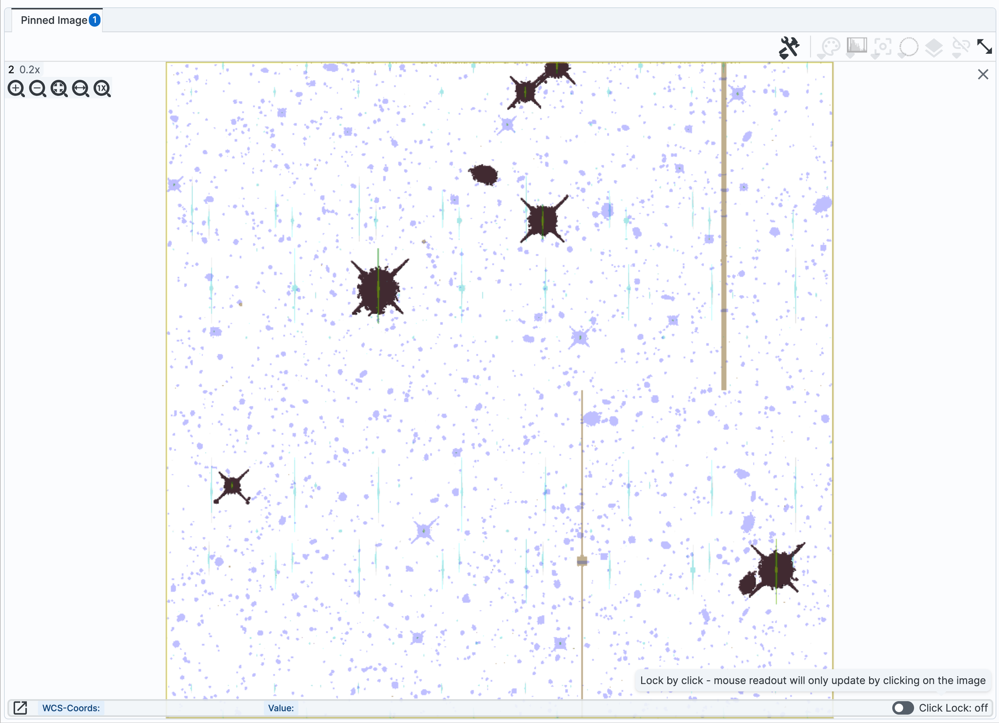

</div>

> **Figure 7:** Mask plane of the `visit_image` image above.

Set all mask key names to transparent except the "DETECTED" mask bit, and display again in frame 1.

In [ ]:
afw_display = afwDisplay.Display(frame=1)
afw_display.setMaskTransparency(100)
afw_display.setMaskTransparency(0, 'DETECTED')

<div style="max-width:400px">

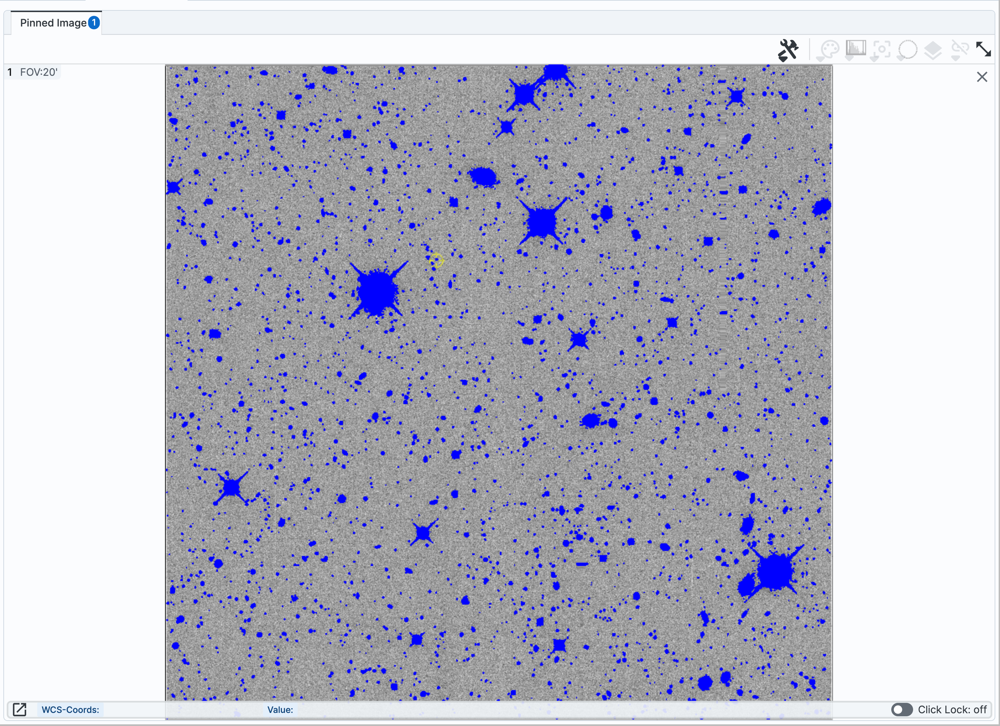

</div>

> **Figure 8:** `DETECTED`mask plane of the `visit_image` image above.

### 4.5 Display with Matplotlib

Mask objects are **bitmasks**, not booleans.
Each bit encodes a different mask plane, so the numeric values cannot be interpreted as straightforward true/false flags.
As a result, plotting the `mask` image plane array **directly** with `matplotlib` can be misleading or confusing.

However, each individual mask plane can be extracted and plotted using `matplotlib` to provide a visualization of which pixels are masked by that specific plane across the image.

In [ ]:
fig = plt.figure(figsize=(12, 12))
for i, (name, bit) in enumerate(mask_visit_image.getMaskPlaneDict().items()):
    fig.add_subplot(5, 5, i + 1)
    plt.imshow(mask_visit_image.array & 2**bit, vmin=0, vmax=1,
               origin='lower', cmap='Greys',
               interpolation='nearest')
    plt.title(name)
    plt.axis('off')

Clean up.

In [ ]:
del mask_visit_image